## iii.	W/ early stop and setting epochs=10 and batch_size=64:

In [1]:
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string

'''
import pandas as pd
df = pd.DataFrame({'Name':[' ADDF  Bertug     Mete     ',' a1234 ','  abcd2   ','Joe    Black    ']})
print (df)


df.Name = df.Name.replace(r'\s+', ' ', regex=True)

#similar solution
#df.Name = df.Name.str.replace(r'\s+', ' ')
print (df)
'''

'''
df.Name.str.lstrip()
print(df)
'''

'\ndf.Name.str.lstrip()\nprint(df)\n'

In [2]:
import time
start = time.time()

In [3]:
pwd

'/content'

In [4]:
import sys
print(sys.executable)

/usr/bin/python3


In [5]:
!pip install plotly
!pip install --upgrade nbformat
!pip install nltk
!pip install spacy # spaCy is an open-source software library for advanced natural language processing
!pip install WordCloud
!pip install gensim # Gensim is an open-source library for unsupervised topic modeling and natural language processing
import nltk
nltk.download('punkt')
!pip install jupyterthemes


from sklearn.model_selection import train_test_split

import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import nltk
import re
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, sent_tokenize
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
# import keras
from tensorflow.keras.preprocessing.text import one_hot, Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Embedding, Input, LSTM, Conv1D, MaxPool1D, Bidirectional
from tensorflow.keras.models import Model
from jupyterthemes import jtplot
#jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False) 
# setting the style of the notebook to be monokai theme  
# this line of code is important to ensure that we are able to see the x and y axes clearly
# If you don't run this code line, you will notice that the xlabel and ylabel on any plot is black on black and it will be hard to see them. 


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
     |████████████████████████████████| 7.0 MB 4.7 MB/s 
     |████████████████████████████████| 46 kB 3.3 MB/s 
     |████████████████████████████████| 9.9 MB 41.8 MB/s 
     |████████████████████████████████| 49 kB 6.3 MB/s 
     |████████████████████████████████| 428 kB 50.0 MB/s 
  Attempting uninstall: tornado
    Found existing installation: tornado 5.1.1
    Uninstalling tornado-5.1.1:
      Successfully uninstalled tornado-5.1.1
  Attempting uninstall: notebook
    Found existing installation: notebook 5.3.1
    Uninstalling notebook-5.3.1:
      Successfully uninstalled notebook-5.3.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires notebook~=5.3.0; python_version >= "3.0", but you have notebook 6.4.11 which is incompatib

In [6]:
#https://www.kaggle.com/questions-and-answers/118932

pd.options.display.max_rows
# Default value of display.max_rows is 10 i.e. at max 10 rows will be printed.
# Set it None to display all rows in the dataframe
pd.set_option('display.max_rows', None)

pd.options.display.max_columns
# Set it to None to display all columns in the dataframe
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

In [7]:
# In Google Colab

from google.colab import files
 
 
uploaded = files.upload()

Saving Womens Clothing E-Commerce Reviews.csv to Womens Clothing E-Commerce Reviews.csv


In [8]:
uploaded

{'Womens Clothing E-Commerce Reviews.csv': b',Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name\n0,767,33,,Absolutely wonderful - silky and sexy and comfortable,4,1,0,Initmates,Intimate,Intimates\n1,1080,34,,"Love this dress!  it\'s sooo pretty.  i happened to find it in a store, and i\'m glad i did bc i never would have ordered it online bc it\'s petite.  i bought a petite and am 5\'8"".  i love the length on me- hits just a little below the knee.  would definitely be a true midi on someone who is truly petite.",5,1,4,General,Dresses,Dresses\n2,1077,60,Some major design flaws,"I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half ha

In [9]:
raw=pd.read_csv('Womens Clothing E-Commerce Reviews.csv',index_col=0)


In [10]:
raw.head()

,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,767,33,NaN,Absolutely wonderful - silky and sexy and comfortable,4,1,0,Initmates,Intimate,Intimates
1,1080,34,NaN,"Love this dress! it's sooo pretty. i happened to find it in a store, and i'm glad i did bc i never would have ordered it online bc it's petite. i bought a petite and am 5'8"". i love the length on me- hits just a little below the knee. would definitely be a true midi on someone who is truly petite.",5,1,4,General,Dresses,Dresses
2,1077,60,Some major design flaws,"I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c",3,0,0,General,Dresses,Dresses
3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments!",5,1,0,General Petite,Bottoms,Pants
4,847,47,Flattering shirt,This shirt is very flattering to all due to the adjustable front tie. it is the perfect length to wear with leggings and it is sleeveless so it pairs well with any cardigan. love this shirt!!!,5,1,6,General,Tops,Blouses


In [11]:
raw.tail()

,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
23481,1104,34,Great dress for many occasions,I was very happy to snag this dress at such a great price! it's very easy to slip on and has a very flattering cut and color combo.,5,1,0,General Petite,Dresses,Dresses
23482,862,48,Wish it was made of cotton,"It reminds me of maternity clothes. soft, stretchy, shiny material. cut is flattering and drapes nicely. i only found one button to close front... looked awkward. nice long sleeves.\nnot for me but maybe for others. just ok.",3,1,0,General Petite,Tops,Knits
23483,1104,31,"Cute, but see through","This fit well, but the top was very see through. this never would have worked for me. i'm glad i was able to try it on in the store and didn't order it online. with different fabric, it would have been great.",3,0,1,General Petite,Dresses,Dresses
23484,1084,28,"Very cute dress, perfect for summer parties and we","I bought this dress for a wedding i have this summer, and it's so cute. unfortunately the fit isn't perfect. the medium fits my waist perfectly, but was way too long and too big in the bust and shoulders. if i wanted to spend the money, i could get it tailored, but i just felt like it might not be worth it. side note - this dress was delivered to me with a nordstrom tag on it and i found it much cheaper there after looking!",3,1,2,General,Dresses,Dresses
23485,1104,52,Please make more like this one!,"This dress in a lovely platinum is feminine and fits perfectly, easy to wear and comfy, too! highly recommend!",5,1,22,General Petite,Dresses,Dresses


In [12]:
raw.shape

(23486, 10)

In [13]:
raw.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23486 entries, 0 to 23485
Data columns (total 10 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Clothing ID              23486 non-null  int64 
 1   Age                      23486 non-null  int64 
 2   Title                    19676 non-null  object
 3   Review Text              22641 non-null  object
 4   Rating                   23486 non-null  int64 
 5   Recommended IND          23486 non-null  int64 
 6   Positive Feedback Count  23486 non-null  int64 
 7   Division Name            23472 non-null  object
 8   Department Name          23472 non-null  object
 9   Class Name               23472 non-null  object
dtypes: int64(5), object(5)
memory usage: 2.0+ MB


In [14]:
# Check sum of missing values by data columns
raw.isnull().sum()

Clothing ID                   0
Age                           0
Title                      3810
Review Text                 845
Rating                        0
Recommended IND               0
Positive Feedback Count       0
Division Name                14
Department Name              14
Class Name                   14
dtype: int64

In [15]:
complete=raw.dropna()

In [16]:
complete.shape

(19662, 10)

In [17]:
# Check sum of missing values by data columns
complete.isnull().sum()

Clothing ID                0
Age                        0
Title                      0
Review Text                0
Rating                     0
Recommended IND            0
Positive Feedback Count    0
Division Name              0
Department Name            0
Class Name                 0
dtype: int64

In [18]:
complete.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19662 entries, 2 to 23485
Data columns (total 10 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Clothing ID              19662 non-null  int64 
 1   Age                      19662 non-null  int64 
 2   Title                    19662 non-null  object
 3   Review Text              19662 non-null  object
 4   Rating                   19662 non-null  int64 
 5   Recommended IND          19662 non-null  int64 
 6   Positive Feedback Count  19662 non-null  int64 
 7   Division Name            19662 non-null  object
 8   Department Name          19662 non-null  object
 9   Class Name               19662 non-null  object
dtypes: int64(5), object(5)
memory usage: 1.7+ MB


In [19]:
print(raw.shape[0]-3810)
print('\nTotal number of entries with at least one missing values: ',raw.shape[0]-complete.shape[0])
print('\nTotal number of entries w/o any missing values: ',complete.shape[0])

19676

Total number of entries with at least one missing values:  3824

Total number of entries w/o any missing values:  19662


In [20]:
# Selecting duplicate rows except first occurrence based on all columns
duplicate = complete[complete.duplicated()]
print(duplicate.shape)

(0, 10)


In [21]:
duplicate.shape

(0, 10)

In [22]:
complete.tail() #w/o reset_index after removing the missing values

,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
23481,1104,34,Great dress for many occasions,I was very happy to snag this dress at such a great price! it's very easy to slip on and has a very flattering cut and color combo.,5,1,0,General Petite,Dresses,Dresses
23482,862,48,Wish it was made of cotton,"It reminds me of maternity clothes. soft, stretchy, shiny material. cut is flattering and drapes nicely. i only found one button to close front... looked awkward. nice long sleeves.\nnot for me but maybe for others. just ok.",3,1,0,General Petite,Tops,Knits
23483,1104,31,"Cute, but see through","This fit well, but the top was very see through. this never would have worked for me. i'm glad i was able to try it on in the store and didn't order it online. with different fabric, it would have been great.",3,0,1,General Petite,Dresses,Dresses
23484,1084,28,"Very cute dress, perfect for summer parties and we","I bought this dress for a wedding i have this summer, and it's so cute. unfortunately the fit isn't perfect. the medium fits my waist perfectly, but was way too long and too big in the bust and shoulders. if i wanted to spend the money, i could get it tailored, but i just felt like it might not be worth it. side note - this dress was delivered to me with a nordstrom tag on it and i found it much cheaper there after looking!",3,1,2,General,Dresses,Dresses
23485,1104,52,Please make more like this one!,"This dress in a lovely platinum is feminine and fits perfectly, easy to wear and comfy, too! highly recommend!",5,1,22,General Petite,Dresses,Dresses


In [23]:
complete.reset_index(drop=True,inplace=True)

In [24]:
complete.tail()

,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
19657,1104,34,Great dress for many occasions,I was very happy to snag this dress at such a great price! it's very easy to slip on and has a very flattering cut and color combo.,5,1,0,General Petite,Dresses,Dresses
19658,862,48,Wish it was made of cotton,"It reminds me of maternity clothes. soft, stretchy, shiny material. cut is flattering and drapes nicely. i only found one button to close front... looked awkward. nice long sleeves.\nnot for me but maybe for others. just ok.",3,1,0,General Petite,Tops,Knits
19659,1104,31,"Cute, but see through","This fit well, but the top was very see through. this never would have worked for me. i'm glad i was able to try it on in the store and didn't order it online. with different fabric, it would have been great.",3,0,1,General Petite,Dresses,Dresses
19660,1084,28,"Very cute dress, perfect for summer parties and we","I bought this dress for a wedding i have this summer, and it's so cute. unfortunately the fit isn't perfect. the medium fits my waist perfectly, but was way too long and too big in the bust and shoulders. if i wanted to spend the money, i could get it tailored, but i just felt like it might not be worth it. side note - this dress was delivered to me with a nordstrom tag on it and i found it much cheaper there after looking!",3,1,2,General,Dresses,Dresses
19661,1104,52,Please make more like this one!,"This dress in a lovely platinum is feminine and fits perfectly, easy to wear and comfy, too! highly recommend!",5,1,22,General Petite,Dresses,Dresses


In [25]:
# drop cuz doesn't add value
del complete['Clothing ID']
#complete.drop(labels='Locations', axis=1)

In [26]:
complete.tail()

,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
19657,34,Great dress for many occasions,I was very happy to snag this dress at such a great price! it's very easy to slip on and has a very flattering cut and color combo.,5,1,0,General Petite,Dresses,Dresses
19658,48,Wish it was made of cotton,"It reminds me of maternity clothes. soft, stretchy, shiny material. cut is flattering and drapes nicely. i only found one button to close front... looked awkward. nice long sleeves.\nnot for me but maybe for others. just ok.",3,1,0,General Petite,Tops,Knits
19659,31,"Cute, but see through","This fit well, but the top was very see through. this never would have worked for me. i'm glad i was able to try it on in the store and didn't order it online. with different fabric, it would have been great.",3,0,1,General Petite,Dresses,Dresses
19660,28,"Very cute dress, perfect for summer parties and we","I bought this dress for a wedding i have this summer, and it's so cute. unfortunately the fit isn't perfect. the medium fits my waist perfectly, but was way too long and too big in the bust and shoulders. if i wanted to spend the money, i could get it tailored, but i just felt like it might not be worth it. side note - this dress was delivered to me with a nordstrom tag on it and i found it much cheaper there after looking!",3,1,2,General,Dresses,Dresses
19661,52,Please make more like this one!,"This dress in a lovely platinum is feminine and fits perfectly, easy to wear and comfy, too! highly recommend!",5,1,22,General Petite,Dresses,Dresses


In [27]:
'''
# https://towardsdatascience.com/text-analysis-feature-engineering-with-nlp-502d6ea9225d
## for language detection
!pip install langdetect 
import langdetect 
from langdetect.lang_detect_exception import LangDetectException
'''

'\n# https://towardsdatascience.com/text-analysis-feature-engineering-with-nlp-502d6ea9225d\n## for language detection\n!pip install langdetect \nimport langdetect \nfrom langdetect.lang_detect_exception import LangDetectException\n'

In [28]:
# test for language detection

#foo = pd.DataFrame({"text": ["hello, this is a tweet", "hola esto es un tweet","Google","https://www.google.com"]})
'''
#foo["language"] = df["text"].apply(detect)
foo['lang'] = foo["text"].apply(lambda x: langdetect.detect(x) if x.strip() != "" else "")
foo


for row in foo:
    try:
        language = detect(row[0])
    except:
        language = "error"
        print("This row throws and error:", row[0])
    row.append(language)
    all.append(row)
'''

# https://towardsdatascience.com/benchmarking-language-detection-for-nlp-8250ea8b67c
'''
from langdetect import DetectorFactory, detect, detect_langs
text = "My lubimy mleko i chleb."
detect(text) #  'cs'
detect_langs(text)  # [cs:0.7142840957132709, pl:0.14285810606233737, sk:0.14285779665739756]
'''

'''
from langdetect import DetectorFactory, detect
from langdetect.lang_detect_exception import LangDetectException
DetectorFactory.seed = 0
def is_english(t):
    try:
        if detect(text) != "en":
            return False
    except LangDetectException:
        return False
    return True
'''

'\nfrom langdetect import DetectorFactory, detect\nfrom langdetect.lang_detect_exception import LangDetectException\nDetectorFactory.seed = 0\ndef is_english(t):\n    try:\n        if detect(text) != "en":\n            return False\n    except LangDetectException:\n        return False\n    return True\n'

In [29]:
'''
from langdetect import DetectorFactory, detect, detect_langs
text = "My lubimy mleko i chleb."
detect(text) #  'cs'
detect_langs(text) 
'''

'\nfrom langdetect import DetectorFactory, detect, detect_langs\ntext = "My lubimy mleko i chleb."\ndetect(text) #  \'cs\'\ndetect_langs(text) \n'

In [30]:
# http://www.cache.one/read/9102073
'''
reader=complete[["Title"]]
for row in reader:
    try:
        language = detect(row[0])
    except:
        language = "error"
        print("This row throws and error:", row[0])
    row.append(language)
    all.append(row)
'''

'\nreader=complete[["Title"]]\nfor row in reader:\n    try:\n        language = detect(row[0])\n    except:\n        language = "error"\n        print("This row throws and error:", row[0])\n    row.append(language)\n    all.append(row)\n'

In [31]:
#complete['Title_lang'] = complete["Title"].apply(lambda x: langdetect.detect(x) if x.strip() != "" else "")

In [32]:
#!pip install fasttext

In [33]:
'''
'import fasttext

path_to_pretrained_model = '/tmp/lid.176.bin'
fmodel = fasttext.load_model(path_to_pretrained_model)
fmodel.predict([text2])  # ([['__label__en']], [array([0.9331119], dtype=float32)]
'''

"\n'import fasttext\n\npath_to_pretrained_model = '/tmp/lid.176.bin'\nfmodel = fasttext.load_model(path_to_pretrained_model)\nfmodel.predict([text2])  # ([['__label__en']], [array([0.9331119], dtype=float32)]\n"

In [34]:
'''
!pip install spacy-langdetect
import spacy
from spacy_langdetect import LanguageDetector
'''

'''
text2 = 'In 1793, Alexander Hamilton recruited Webster to move to New York City and become an editor for a Federalist Party newspaper.'
nlp = spacy.load('en_core_web_sm')
nlp.add_pipe(LanguageDetector(), name='language_detector', last=True)
doc = nlp(text2)
doc._.language  # {'language': 'en', 'score': 0.9999978351575265}
'''

'''
foo = pd.DataFrame({"text": ["hello, this is a tweet", "hola esto es un tweet","Google","https://www.google.com"]})
nlp = spacy.load('en_core_web_sm')
nlp.add_pipe(LanguageDetector(), name='language_detector', last=True)
doc = nlp(foo)
doc._.language
'''


'\nfoo = pd.DataFrame({"text": ["hello, this is a tweet", "hola esto es un tweet","Google","https://www.google.com"]})\nnlp = spacy.load(\'en_core_web_sm\')\nnlp.add_pipe(LanguageDetector(), name=\'language_detector\', last=True)\ndoc = nlp(foo)\ndoc._.language\n'

In [35]:
complete.describe().round(3).T

,count,mean,std,min,25%,50%,75%,max
Age,19662.0,43.261,12.258,18.0,34.0,41.0,52.0,99.0
Rating,19662.0,4.183,1.112,1.0,4.0,5.0,5.0,5.0
Recommended IND,19662.0,0.818,0.386,0.0,1.0,1.0,1.0,1.0
Positive Feedback Count,19662.0,2.652,5.834,0.0,0.0,1.0,3.0,122.0


In [36]:
recommend=complete['Recommended IND'].value_counts()
recommend

1    16087
0     3575
Name: Recommended IND, dtype: int64

In [37]:
print(recommend[0])
print(recommend[1])

3575
16087


In [38]:
# Inbalance class
complete['Recommended IND'].value_counts(normalize=True)


1    0.818177
0    0.181823
Name: Recommended IND, dtype: float64

In [39]:
# Pie chart of class imbalance
import plotly.graph_objects as go
fig=go.Figure(data=[go.Pie(labels=['Recommended (1), n = ' + str(recommend[1]),
                                   'Not recommended (0), n = ' + str(recommend[0])],
                           values=complete['Recommended IND'].value_counts())])
fig.show()

In [40]:
complete[['Age','Rating','Positive Feedback Count']].describe().round(3).T

,count,mean,std,min,25%,50%,75%,max
Age,19662.0,43.261,12.258,18.0,34.0,41.0,52.0,99.0
Rating,19662.0,4.183,1.112,1.0,4.0,5.0,5.0,5.0
Positive Feedback Count,19662.0,2.652,5.834,0.0,0.0,1.0,3.0,122.0


In [41]:
complete.groupby('Recommended IND')['Age','Rating','Positive Feedback Count'].describe().round(3).T

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



Recommended IND                       0          1
Age                     count  3575.000  16087.000
                        mean     42.340     43.465
                        std      11.716     12.366
                        min      19.000     18.000
                        25%      34.000     34.000
                        50%      40.000     41.000
                        75%      50.000     52.000
                        max      91.000     99.000
Rating                  count  3575.000  16087.000
                        mean      2.312      4.599
                        std       0.845      0.634
                        min       1.000      1.000
                        25%       2.000      4.000
                        50%       2.000      5.000
                        75%       3.000      5.000
                        max       5.000      5.000
Positive Feedback Count count  3575.000  16087.000
                        mean      3.388      2.489
                        std       6.614      5.634
                        min       0.000      0.000
                        25%       0.000      0.000
                        50%       1.000      1.000
                        75%       4.000      3.000
                        max     108.000    122.000

In [42]:
'''
corr_matrix=complete[['Age','Rating','Positive Feedback Count']].corr()
plt.figure(figsize=(20,20))
mask=np.triu(np.ones_like(corr_matrix, dtype=bool))
sns.heatmap(corr_matrix,annot=True, fmt='0.3f',mask=mask)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.title('Correlation Matrix',fontsize=20)
plt.show()
'''

"\ncorr_matrix=complete[['Age','Rating','Positive Feedback Count']].corr()\nplt.figure(figsize=(20,20))\nmask=np.triu(np.ones_like(corr_matrix, dtype=bool))\nsns.heatmap(corr_matrix,annot=True, fmt='0.3f',mask=mask)\nplt.xticks(rotation=45)\nplt.yticks(rotation=0)\nplt.title('Correlation Matrix',fontsize=20)\nplt.show()\n"

In [43]:
# https://www.datasciencemadesimple.com/cross-tab-cross-table-python-pandas/
# 2 way cross table
 
pd.crosstab(complete['Division Name'], complete['Recommended IND'],margins=True)

Recommended IND,0,1,All
Division Name,,,
General,2174,9490,11664
General Petite,1215,5563,6778
Initmates,186,1034,1220
All,3575,16087,19662


In [44]:
pd.crosstab(complete['Department Name'], complete['Recommended IND'],margins=True)

Recommended IND,0,1,All
Department Name,,,
Bottoms,469,2715,3184
Dresses,1057,4314,5371
Intimate,217,1191,1408
Jackets,140,739,879
Tops,1666,7047,8713
Trend,26,81,107
All,3575,16087,19662


In [45]:
pd.crosstab(complete['Class Name'], complete['Recommended IND'],margins=True)

Recommended IND,0,1,All
Class Name,,,
Blouses,493,2094,2587
Casual bottoms,0,1,1
Chemises,0,1,1
Dresses,1057,4314,5371
Fine gauge,153,774,927
Intimates,16,104,120
Jackets,90,508,598
Jeans,120,850,970
Knits,771,3210,3981


In [46]:
'''
['Age'].hist(figsize=(12, 6))
plt.show()
'''

"\n['Age'].hist(figsize=(12, 6))\nplt.show()\n"

In [47]:
# https://stackoverflow.com/questions/35692781/python-plotting-percentage-in-seaborn-bar-plot
'''
def with_hue(plot, feature, Number_of_categories, hue_categories):
    a = [p.get_height() for p in plot.patches]
    patch = [p for p in plot.patches]
    for i in range(Number_of_categories):
        total = feature.value_counts().values[i]
        for j in range(hue_categories):
            percentage = '{:.1f}%'.format(100 * a[(j*Number_of_categories + i)]/total)
            x = patch[(j*Number_of_categories + i)].get_x() + patch[(j*Number_of_categories + i)].get_width() / 2 - 0.15
            y = patch[(j*Number_of_categories + i)].get_y() + patch[(j*Number_of_categories + i)].get_height() 
            ax.annotate(percentage, (x, y), size = 12)
    plt.show()
'''

"\ndef with_hue(plot, feature, Number_of_categories, hue_categories):\n    a = [p.get_height() for p in plot.patches]\n    patch = [p for p in plot.patches]\n    for i in range(Number_of_categories):\n        total = feature.value_counts().values[i]\n        for j in range(hue_categories):\n            percentage = '{:.1f}%'.format(100 * a[(j*Number_of_categories + i)]/total)\n            x = patch[(j*Number_of_categories + i)].get_x() + patch[(j*Number_of_categories + i)].get_width() / 2 - 0.15\n            y = patch[(j*Number_of_categories + i)].get_y() + patch[(j*Number_of_categories + i)].get_height() \n            ax.annotate(percentage, (x, y), size = 12)\n    plt.show()\n"

In [48]:
'''
plt.figure(figsize=(7,5))
ax=sns.countplot(complete['Division Name'],hue=complete['Recommended IND'],data=complete)
plt.xticks(complete['Division Name'],size=12)
plt.yticks(size=12)
plt.ylabel('count',size=12)
with_hue(ax,complete['Division Name'],2,2)
'''

"\nplt.figure(figsize=(7,5))\nax=sns.countplot(complete['Division Name'],hue=complete['Recommended IND'],data=complete)\nplt.xticks(complete['Division Name'],size=12)\nplt.yticks(size=12)\nplt.ylabel('count',size=12)\nwith_hue(ax,complete['Division Name'],2,2)\n"

In [49]:
!pip install dexplot

     |████████████████████████████████| 173 kB 4.7 MB/s 


In [50]:
import dexplot as dxp

dexplt=complete.copy()
dexplt.rename(columns={"Recommended IND": "Recommended"},inplace=True)
dexplt.loc[dexplt['Recommended'] ==0, 'Recommended'] = 'No'
dexplt.loc[dexplt['Recommended'] ==1, 'Recommended'] = 'Yes'

dexplt.tail()

,Age,Title,Review Text,Rating,Recommended,Positive Feedback Count,Division Name,Department Name,Class Name
19657,34,Great dress for many occasions,I was very happy to snag this dress at such a great price! it's very easy to slip on and has a very flattering cut and color combo.,5,Yes,0,General Petite,Dresses,Dresses
19658,48,Wish it was made of cotton,"It reminds me of maternity clothes. soft, stretchy, shiny material. cut is flattering and drapes nicely. i only found one button to close front... looked awkward. nice long sleeves.\nnot for me but maybe for others. just ok.",3,Yes,0,General Petite,Tops,Knits
19659,31,"Cute, but see through","This fit well, but the top was very see through. this never would have worked for me. i'm glad i was able to try it on in the store and didn't order it online. with different fabric, it would have been great.",3,No,1,General Petite,Dresses,Dresses
19660,28,"Very cute dress, perfect for summer parties and we","I bought this dress for a wedding i have this summer, and it's so cute. unfortunately the fit isn't perfect. the medium fits my waist perfectly, but was way too long and too big in the bust and shoulders. if i wanted to spend the money, i could get it tailored, but i just felt like it might not be worth it. side note - this dress was delivered to me with a nordstrom tag on it and i found it much cheaper there after looking!",3,Yes,2,General,Dresses,Dresses
19661,52,Please make more like this one!,"This dress in a lovely platinum is feminine and fits perfectly, easy to wear and comfy, too! highly recommend!",5,Yes,22,General Petite,Dresses,Dresses


In [51]:
complete.tail()

,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
19657,34,Great dress for many occasions,I was very happy to snag this dress at such a great price! it's very easy to slip on and has a very flattering cut and color combo.,5,1,0,General Petite,Dresses,Dresses
19658,48,Wish it was made of cotton,"It reminds me of maternity clothes. soft, stretchy, shiny material. cut is flattering and drapes nicely. i only found one button to close front... looked awkward. nice long sleeves.\nnot for me but maybe for others. just ok.",3,1,0,General Petite,Tops,Knits
19659,31,"Cute, but see through","This fit well, but the top was very see through. this never would have worked for me. i'm glad i was able to try it on in the store and didn't order it online. with different fabric, it would have been great.",3,0,1,General Petite,Dresses,Dresses
19660,28,"Very cute dress, perfect for summer parties and we","I bought this dress for a wedding i have this summer, and it's so cute. unfortunately the fit isn't perfect. the medium fits my waist perfectly, but was way too long and too big in the bust and shoulders. if i wanted to spend the money, i could get it tailored, but i just felt like it might not be worth it. side note - this dress was delivered to me with a nordstrom tag on it and i found it much cheaper there after looking!",3,1,2,General,Dresses,Dresses
19661,52,Please make more like this one!,"This dress in a lovely platinum is feminine and fits perfectly, easy to wear and comfy, too! highly recommend!",5,1,22,General Petite,Dresses,Dresses


/usr/local/lib/python3.7/dist-packages/pandas/core/arrays/categorical.py:2631: FutureWarning:

The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


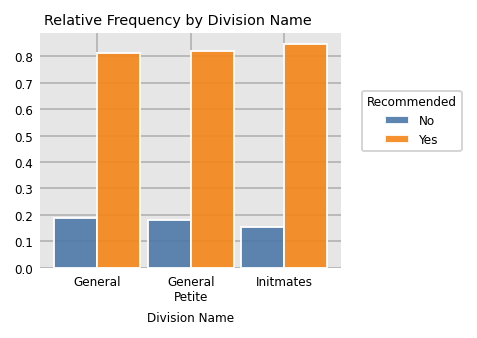

In [52]:
dxp.count('Division Name', 
          data=dexplt, 
          split='Recommended', 
          normalize='Division Name',
          title='Relative Frequency by Division Name',)

/usr/local/lib/python3.7/dist-packages/pandas/core/arrays/categorical.py:2631: FutureWarning:

The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.



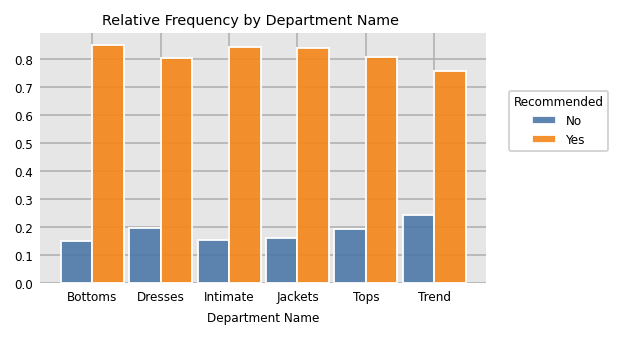

In [53]:
dxp.count('Department Name', 
          data=dexplt, 
          split='Recommended', 
          normalize='Department Name',
          title='Relative Frequency by Department Name')

In [54]:
'''
ax = sns.histplot(x =complete['Division Name'], hue=complete['Recommended IND'], multiple="dodge", 
                  stat = 'density', shrink = 0.8, common_norm=False)

plt.show()
'''

'\nax = sns.histplot(x =complete[\'Division Name\'], hue=complete[\'Recommended IND\'], multiple="dodge", \n                  stat = \'density\', shrink = 0.8, common_norm=False)\n\nplt.show()\n'

/usr/local/lib/python3.7/dist-packages/pandas/core/arrays/categorical.py:2631: FutureWarning:

The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.



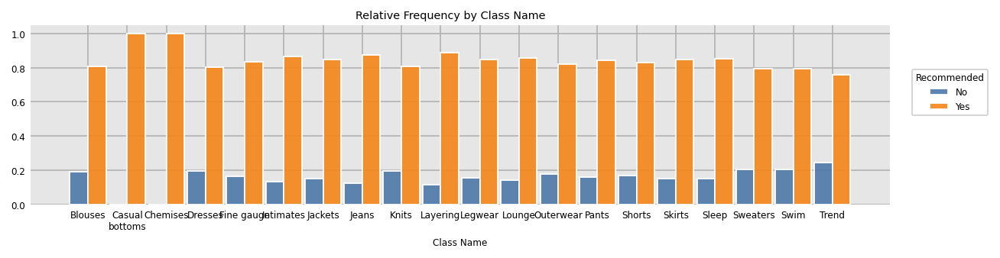

In [55]:
dxp.count('Class Name', 
          data=dexplt, 
          split='Recommended', 
          normalize='Class Name',
          title='Relative Frequency by Class Name')

In [56]:
# https://mccormickml.com/2021/06/29/combining-categorical-numerical-features-with-bert/#33-tokenize--encode
# C:\Users\K C Wong\OneDrive\Documents\E-learning\References\Python\Combining Categorical and Numerical Features with Text in BERT

# This will hold all of the dataset samples, as strings. 
sen_w_feats = []

# The labels for the samples.
labels = []

'''
# First, reload the dataset to undo the transformations we applied for XGBoost.
data_df = pd.read_csv('Womens Clothing E-Commerce Reviews.csv', index_col=0)

# Some of the reviews are missing either a "Title" or "Review Text", so we'll 
# replace the NaN values with empty string.
data_df = data_df.fillna("")
'''

print('Combining features into strings...excl. Positive Feedback Count')

# For each of the samples...
for index, row in complete.iterrows():

    # Piece it together...    
    combined = ""
    
    #combined += "The ID of this item is {:}, ".format(row["Clothing ID"])
    combined += "This item comes from the {:} department and {:} division, " \
                "and is classified under {:}. ".format(row["Department Name"], 
                                                       row["Division Name"], 
                                                       row["Class Name"])
    
    combined += "I am {:} years old. ".format(row["Age"])
    
    combined += "I rate this item {:} out of 5 stars. ".format(row["Rating"])
    
    # Not all samples have titles.
    if not row["Title"] == "":
        combined += row["Title"] + ". "
    
    # Finally, append the review the text!
    combined += row["Review Text"]
    
    # Add the combined text to the list.
    sen_w_feats.append(combined)

    # Also record the sample's label.
    labels.append(row["Recommended IND"])

print('  DONE.')

print('Dataset contains {:,} samples.'.format(len(sen_w_feats)))

Combining features into strings...excl. Positive Feedback Count
  DONE.
Dataset contains 19,662 samples.


### https://www.coursera.org/learn/nlp-fake-news-detector/home/welcome

#### Not gonna apply stop words

In [57]:
# download stopwords
#nltk.download("stopwords")

In [58]:
# Obtain additional stopwords from nltk
'''
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words
'''

"\nfrom nltk.corpus import stopwords\nstop_words = stopwords.words('english')\nstop_words\n"

In [59]:
# Remove stopwords and remove words with 2 or less characters
'''
def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        # if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3 and token not in stop_words:
        if token not in gensim.parsing.preprocessing.STOPWORDS and token not in stop_words:
            result.append(token)
            
    return result
'''

'\ndef preprocess(text):\n    result = []\n    for token in gensim.utils.simple_preprocess(text):\n        # if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3 and token not in stop_words:\n        if token not in gensim.parsing.preprocessing.STOPWORDS and token not in stop_words:\n            result.append(token)\n            \n    return result\n'

In [60]:
# Change list to dataframe
text_df = pd.DataFrame(sen_w_feats, columns =['text']) 

In [61]:
text_df.text = text_df.text.replace(r'\s+', ' ', regex=True)

In [62]:
text_df.head(3)

,text
0,"This item comes from the Dresses department and General division, and is classified under Dresses. I am 60 years old. I rate this item 3 out of 5 stars. Some major design flaws. I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c"
1,"This item comes from the Bottoms department and General Petite division, and is classified under Pants. I am 50 years old. I rate this item 5 out of 5 stars. My favorite buy!. I love, love, love this jumpsuit. it's fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments!"
2,"This item comes from the Tops department and General division, and is classified under Blouses. I am 47 years old. I rate this item 5 out of 5 stars. Flattering shirt. This shirt is very flattering to all due to the adjustable front tie. it is the perfect length to wear with leggings and it is sleeveless so it pairs well with any cardigan. love this shirt!!!"


In [63]:
# Change list to dataframe
recommend_df = pd.DataFrame(labels, columns =['Recommended']) 

In [64]:
recommend_df.head(3)

,Recommended
0,0
1,1
2,1


In [65]:
# combine text and target column into a dataframe
combined=pd.concat((text_df, recommend_df), axis=1)
combined['text']=combined['text'].str.lower()

In [66]:
combined.head(3)

,text,Recommended
0,"this item comes from the dresses department and general division, and is classified under dresses. i am 60 years old. i rate this item 3 out of 5 stars. some major design flaws. i had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c",0
1,"this item comes from the bottoms department and general petite division, and is classified under pants. i am 50 years old. i rate this item 5 out of 5 stars. my favorite buy!. i love, love, love this jumpsuit. it's fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments!",1
2,"this item comes from the tops department and general division, and is classified under blouses. i am 47 years old. i rate this item 5 out of 5 stars. flattering shirt. this shirt is very flattering to all due to the adjustable front tie. it is the perfect length to wear with leggings and it is sleeveless so it pairs well with any cardigan. love this shirt!!!",1


In [67]:
combined.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19662 entries, 0 to 19661
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   text         19662 non-null  object
 1   Recommended  19662 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 307.3+ KB


In [68]:
# Apply the preprocess function to the dataframe
#combined['clean'] = combined['text'].apply(preprocess)

In [69]:
combined.head(3)

,text,Recommended
0,"this item comes from the dresses department and general division, and is classified under dresses. i am 60 years old. i rate this item 3 out of 5 stars. some major design flaws. i had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c",0
1,"this item comes from the bottoms department and general petite division, and is classified under pants. i am 50 years old. i rate this item 5 out of 5 stars. my favorite buy!. i love, love, love this jumpsuit. it's fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments!",1
2,"this item comes from the tops department and general division, and is classified under blouses. i am 47 years old. i rate this item 5 out of 5 stars. flattering shirt. this shirt is very flattering to all due to the adjustable front tie. it is the perfect length to wear with leggings and it is sleeveless so it pairs well with any cardigan. love this shirt!!!",1


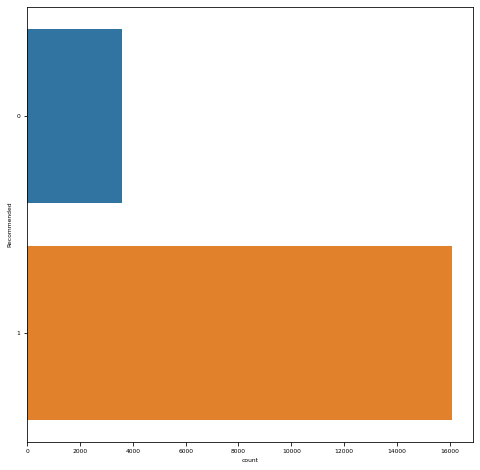

In [70]:
plt.figure(figsize = (8, 8))
sns.countplot(y = "Recommended", data = combined)

# Imbalane dataset

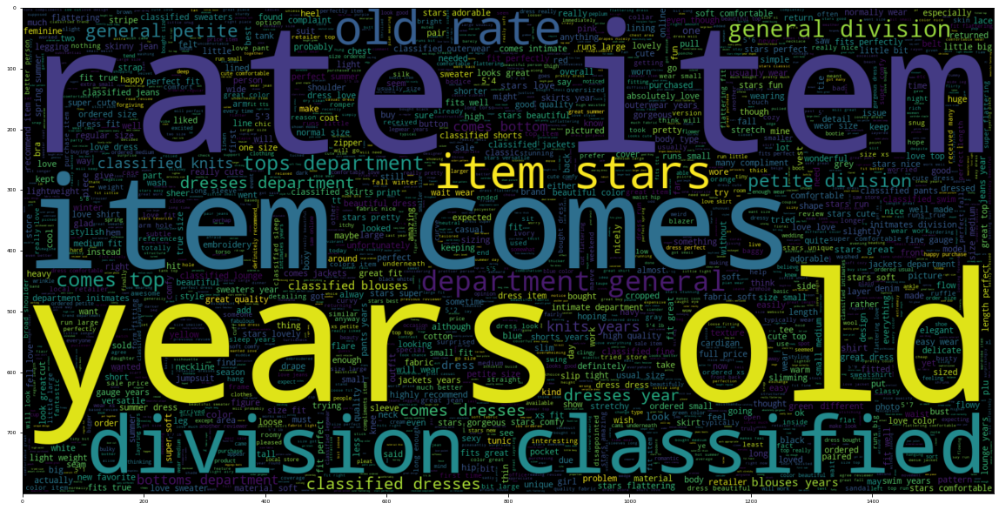

In [71]:
# Most 2000 common words from the complete dataset when Recommended = 1
# plot the word cloud for text that is Recommended
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(combined[combined.Recommended == 1].text))
plt.imshow(wc, interpolation = 'bilinear')

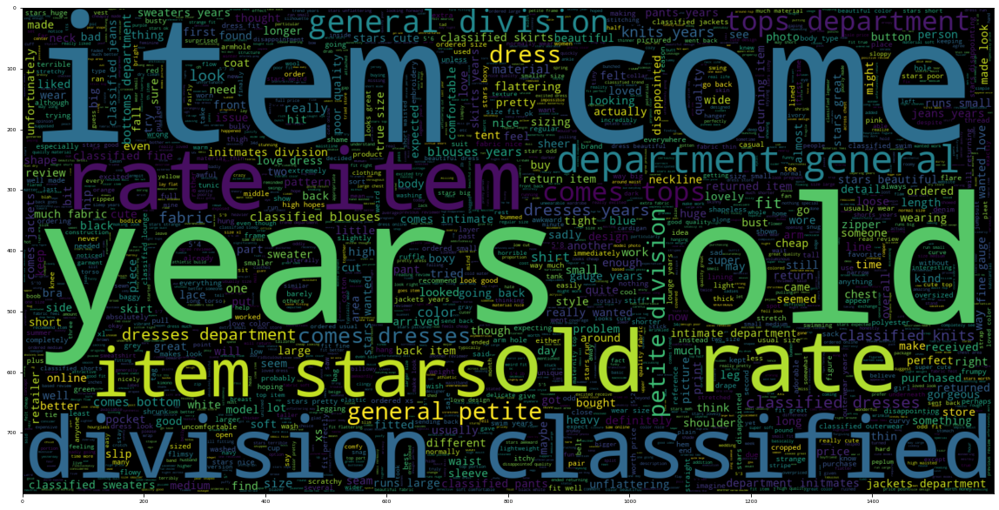

In [72]:
# plot the word cloud for text that is not recommended
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(combined[combined.Recommended == 0].text))
plt.imshow(wc, interpolation = 'bilinear')

In [73]:
# test
nltk.word_tokenize(combined['text'][0])

['this',
 'item',
 'comes',
 'from',
 'the',
 'dresses',
 'department',
 'and',
 'general',
 'division',
 ',',
 'and',
 'is',
 'classified',
 'under',
 'dresses',
 '.',
 'i',
 'am',
 '60',
 'years',
 'old',
 '.',
 'i',
 'rate',
 'this',
 'item',
 '3',
 'out',
 'of',
 '5',
 'stars',
 '.',
 'some',
 'major',
 'design',
 'flaws',
 '.',
 'i',
 'had',
 'such',
 'high',
 'hopes',
 'for',
 'this',
 'dress',
 'and',
 'really',
 'wanted',
 'it',
 'to',
 'work',
 'for',
 'me',
 '.',
 'i',
 'initially',
 'ordered',
 'the',
 'petite',
 'small',
 '(',
 'my',
 'usual',
 'size',
 ')',
 'but',
 'i',
 'found',
 'this',
 'to',
 'be',
 'outrageously',
 'small',
 '.',
 'so',
 'small',
 'in',
 'fact',
 'that',
 'i',
 'could',
 'not',
 'zip',
 'it',
 'up',
 '!',
 'i',
 'reordered',
 'it',
 'in',
 'petite',
 'medium',
 ',',
 'which',
 'was',
 'just',
 'ok.',
 'overall',
 ',',
 'the',
 'top',
 'half',
 'was',
 'comfortable',
 'and',
 'fit',
 'nicely',
 ',',
 'but',
 'the',
 'bottom',
 'half',
 'had',
 'a',
 '

In [74]:
combined['text'][0]

'this item comes from the dresses department and general division, and is classified under dresses. i am 60 years old. i rate this item 3 out of 5 stars. some major design flaws. i had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c'

In [75]:
# length of maximum document will be needed to create word embeddings 
maxlen = -1
for doc in combined.text:
    tokens = nltk.word_tokenize(doc)
    if(maxlen<len(tokens)):
        maxlen = len(tokens)
print("The maximum number of words in any document is =", maxlen)

The maximum number of words in any document is = 173


In [76]:
# https://forums.fast.ai/t/google-colab-pip-install-fastbook-produces-dependency-error-with-tornado-v6-1/94109/6

!pip install fastbook==0.0.17

!pip uninstall tornado -y

!yes | pip install tornado==5.1.0

import fastbook

fastbook.setup_book()

# visualize the distribution of number of words in a text
import plotly.express as px
fig = px.histogram(x = [len(nltk.word_tokenize(x)) for x in combined.text], nbins = 100)
fig.show()

# majority of the comnbined text Most text i.e. count>600 at around x=150words.

     |████████████████████████████████| 719 kB 5.7 MB/s 
     |████████████████████████████████| 49 kB 5.5 MB/s 
     |████████████████████████████████| 188 kB 50.1 MB/s 
     |████████████████████████████████| 1.2 MB 29.8 MB/s 
     |████████████████████████████████| 60 kB 6.6 MB/s 
     |████████████████████████████████| 561 kB 55.5 MB/s 
     |████████████████████████████████| 53 kB 2.4 MB/s 
     |████████████████████████████████| 133 kB 48.4 MB/s 
     |████████████████████████████████| 130 kB 51.6 MB/s 
  Attempting uninstall: jupyter-client
    Found existing installation: jupyter-client 5.3.5
    Uninstalling jupyter-client-5.3.5:
      Successfully uninstalled jupyter-client-5.3.5
  Attempting uninstall: Jinja2
    Found existing installation: Jinja2 2.11.3
    Uninstalling Jinja2-2.11.3:
      Successfully uninstalled Jinja2-2.11.3
  Attempting uninstall: nbconvert
    Found existing installation: nbconvert 5.6.1
    Uninstalling nbconvert-5.6.1:
      Successfully uninstalle

Found existing installation: tornado 6.1
Uninstalling tornado-6.1:
  Successfully uninstalled tornado-6.1
     |████████████████████████████████| 516 kB 5.4 MB/s 
  Created wheel for tornado: filename=tornado-5.1-cp37-cp37m-linux_x86_64.whl size=462815 sha256=6802f15f570f9a8f94973ff719c03d1f8a865e830469da6ccb09c939ab6a8ba5
  Stored in directory: /root/.cache/pip/wheels/8e/53/de/6a6860ebf6d2958e20a9a8337f25b0369f1666002ade0ce284
Successfully built tornado
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
notebook 6.4.11 requires tornado>=6.1, but you have tornado 5.1 which is incompatible.
jupyter-client 7.3.0 requires tornado>=6.0, but you have tornado 5.1 which is incompatible.
google-colab 1.0.0 requires notebook~=5.3.0; python_version >= "3.0", but you have notebook 6.4.11 which is incompatible.
Mounted at /content/gdrive


In [77]:
sen_w_feats[0], labels[0]

('This item comes from the Dresses department and General division, and is classified under Dresses. I am 60 years old. I rate this item 3 out of 5 stars. Some major design flaws. I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c',
 0)

In [78]:
complete.head(1)

,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,60,Some major design flaws,"I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c",3,0,0,General,Dresses,Dresses


In [79]:
sen_w_feats[19661],labels[19661]

('This item comes from the Dresses department and General Petite division, and is classified under Dresses. I am 52 years old. I rate this item 5 out of 5 stars. Please make more like this one!. This dress in a lovely platinum is feminine and fits perfectly, easy to wear and comfy, too! highly recommend!',
 1)

In [80]:
# take a look at one entry from complete set
complete.tail(1)

,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
19661,52,Please make more like this one!,"This dress in a lovely platinum is feminine and fits perfectly, easy to wear and comfy, too! highly recommend!",5,1,22,General Petite,Dresses,Dresses


### https://www.coursera.org/learn/nlp-fake-news-detector/home/welcome

In [81]:
'''
pip install nltk
nltk.download("stopwords")
'''

'\npip install nltk\nnltk.download("stopwords")\n'

In [82]:
# Remove stopwords and remove words with 2 or less characters
'''
def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        result.append(token)
            
    return result
'''

'\ndef preprocess(text):\n    result = []\n    for token in gensim.utils.simple_preprocess(text):\n        result.append(token)\n            \n    return result\n'

In [83]:
'''
from nltk.tokenize import word_tokenize
text = "God is Great! I won a lottery. 123"
print(word_tokenize(text))
'''

'\nfrom nltk.tokenize import word_tokenize\ntext = "God is Great! I won a lottery. 123"\nprint(word_tokenize(text))\n'

In [84]:
# Apply the function to the dataframe
#combined['words'] = combined['text'].apply(preprocess)

In [85]:
# https://www.coursera.org/learn/nlp-fake-news-detector/ungradedLti/GBwpm/fake-news-detection-with-machine-learning
# Obtain the total words present in the dataset

combined["words"]= combined["text"].str.split()

list_of_words = []
for i in combined.words:
    for j in i:
        list_of_words.append(j)

In [86]:
combined.head(10)

,text,Recommended,words
0,"this item comes from the dresses department and general division, and is classified under dresses. i am 60 years old. i rate this item 3 out of 5 stars. some major design flaws. i had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. im...",0,"[this, item, comes, from, the, dresses, department, and, general, division,, and, is, classified, under, dresses., i, am, 60, years, old., i, rate, this, item, 3, out, of, 5, stars., some, major, design, flaws., i, had, such, high, hopes, for, this, dress, and, really, wanted, it, to, work, for, me., i, initially, ordered, the, petite, small, (my, usual, size), but, i, found, this, to, be, outrageously, small., so, small, in, fact, that, i, could, not, zip, it, up!, i, reordered, it, in, petite, medium,, which, was, just, ok., overall,, the, top, half, was, comfortable, and, fit, nicely,, ..."
1,"this item comes from the bottoms department and general petite division, and is classified under pants. i am 50 years old. i rate this item 5 out of 5 stars. my favorite buy!. i love, love, love this jumpsuit. it's fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments!",1,"[this, item, comes, from, the, bottoms, department, and, general, petite, division,, and, is, classified, under, pants., i, am, 50, years, old., i, rate, this, item, 5, out, of, 5, stars., my, favorite, buy!., i, love,, love,, love, this, jumpsuit., it's, fun,, flirty,, and, fabulous!, every, time, i, wear, it,, i, get, nothing, but, great, compliments!]"
2,"this item comes from the tops department and general division, and is classified under blouses. i am 47 years old. i rate this item 5 out of 5 stars. flattering shirt. this shirt is very flattering to all due to the adjustable front tie. it is the perfect length to wear with leggings and it is sleeveless so it pairs well with any cardigan. love this shirt!!!",1,"[this, item, comes, from, the, tops, department, and, general, division,, and, is, classified, under, blouses., i, am, 47, years, old., i, rate, this, item, 5, out, of, 5, stars., flattering, shirt., this, shirt, is, very, flattering, to, all, due, to, the, adjustable, front, tie., it, is, the, perfect, length, to, wear, with, leggings, and, it, is, sleeveless, so, it, pairs, well, with, any, cardigan., love, this, shirt!!!]"
3,"this item comes from the dresses department and general division, and is classified under dresses. i am 49 years old. i rate this item 2 out of 5 stars. not for the very petite. i love tracy reese dresses, but this one is not for the very petite. i am just under 5 feet tall and usually wear a 0p in this brand. this dress was very pretty out of the package but its a lot of dress. the skirt is long and very full so it overwhelmed my small frame. not a stranger to alterations, shortening and narrowing the skirt would take away from the embellishment of the garment. i love the color and the id...",0,"[this, item, comes, from, the, dresses, department, and, general, division,, and, is, classified, under, dresses., i, am, 49, years, old., i, rate, this, item, 2, out, of, 5, stars., not, for, the, very, petite., i, love, tracy, reese, dresses,, but, this, one, is, not, for, the, very, petite., i, am, just, under, 5, feet, tall, and, usually, wear, a, 0p, in, this, brand., this, dress, was, very, pretty, out, of, the, package, but, its, a, lot, of, dress., the, skirt, is, long, and, very, full, so, it, overwhelmed, my, small, frame., not, a, stranger, to, alterations,, shortening, and, nar..."
4,"this item comes from the tops department and general petite division, and is classified under

In [87]:
list_of_words

['this',
 'item',
 'comes',
 'from',
 'the',
 'dresses',
 'department',
 'and',
 'general',
 'division,',
 'and',
 'is',
 'classified',
 'under',
 'dresses.',
 'i',
 'am',
 '60',
 'years',
 'old.',
 'i',
 'rate',
 'this',
 'item',
 '3',
 'out',
 'of',
 '5',
 'stars.',
 'some',
 'major',
 'design',
 'flaws.',
 'i',
 'had',
 'such',
 'high',
 'hopes',
 'for',
 'this',
 'dress',
 'and',
 'really',
 'wanted',
 'it',
 'to',
 'work',
 'for',
 'me.',
 'i',
 'initially',
 'ordered',
 'the',
 'petite',
 'small',
 '(my',
 'usual',
 'size)',
 'but',
 'i',
 'found',
 'this',
 'to',
 'be',
 'outrageously',
 'small.',
 'so',
 'small',
 'in',
 'fact',
 'that',
 'i',
 'could',
 'not',
 'zip',
 'it',
 'up!',
 'i',
 'reordered',
 'it',
 'in',
 'petite',
 'medium,',
 'which',
 'was',
 'just',
 'ok.',
 'overall,',
 'the',
 'top',
 'half',
 'was',
 'comfortable',
 'and',
 'fit',
 'nicely,',
 'but',
 'the',
 'bottom',
 'half',
 'had',
 'a',
 'very',
 'tight',
 'under',
 'layer',
 'and',
 'several',
 'somewh

In [88]:
len(list_of_words)

# 1864981

1864981

In [89]:
# Obtain the total number of unique words
total_words = len(list(set(list_of_words)))
total_words

# 38291

38291

### https://actsusanli.medium.com/fake-news-classification-with-lstm-or-logistic-regression-82a3527aaf13

In [90]:
X = combined['text']
y = combined['Recommended']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42,stratify=y)

'''
from imblearn.combine import SMOTETomek
smote_tomek = SMOTETomek(random_state=42)
X_train,y_train=smote_tomek.fit_resample(X_train0,y_train0)
'''


'\nfrom imblearn.combine import SMOTETomek\nsmote_tomek = SMOTETomek(random_state=42)\nX_train,y_train=smote_tomek.fit_resample(X_train0,y_train0)\n'

In [91]:
X_train

11528    this item comes from the dresses department and general division, and is classified under dresses. i am 26 years old. i rate this item 5 out of 5 stars. proceed with caution if you are busty!. i absolutely love this dress! it's a great summer dress that's flirty and fun. i feel this dress runs pretty true to size except in the bust area. the buttons at the top pull a little bit on me unless i wear a bra that pushes the girls up and together. i'm a 32ddd just so you have an idea. i'm 5'10, about 145-150 lbs and i'm a 4-6. in dresses i'm usually able to get away with a 4. i have a bigger bus...
429                                                                                                                  this item comes from the tops department and general division, and is classified under blouses. i am 52 years old. i rate this item 5 out of 5 stars. love, love, love this tunic!. perfect little summer tunic that is very flattering. paired with a skirt, jeans or cropped bla

In [92]:
y_train

11528    1
429      1
14865    0
7911     1
14251    1
3921     1
11401    1
4657     1
15351    0
18454    1
19591    1
16177    1
9241     1
14725    1
5837     1
10033    1
4062     0
5884     1
1581     1
13843    1
18083    1
11314    1
7076     1
5243     1
2102     1
16265    1
9848     1
11455    1
10479    1
15286    1
8611     1
6550     1
8756     1
10482    1
13058    1
9555     1
8399     1
14311    1
11615    1
11772    1
12375    0
7598     1
19074    1
4196     1
18132    1
8305     1
895      1
3092     0
4467     1
5037     1
13793    1
18409    1
13201    1
13284    0
12104    1
186      0
3156     1
13620    0
954      1
15061    1
11245    1
13355    1
19512    1
8392     1
12282    1
19238    1
2500     1
17984    1
5732     1
17846    1
4563     1
1622     1
10040    1
1281     1
11598    1
5216     1
17310    0
2467     1
8128     1
7856     1
9646     0
13307    0
6029     1
7188     0
14651    0
12026    0
5006     1
12768    1
5008     1
5834     1
13721    1

In [93]:
X_test

16198                                                                                              this item comes from the dresses department and general petite division, and is classified under dresses. i am 36 years old. i rate this item 5 out of 5 stars. absolutely adorable. i'm in love ... with this super cute dress!!! the material feels so good on my skin and it has more 'body' than it appears on the pic ! i'm 5'2" 115 lbs - i bought the s petite and it's perfect for me - slightly loose - i could have probably fit in an xs but i like the freedom that the s gives me! it my official spring dress !
18432                                                                                                                                                                                                               this item comes from the tops department and general division, and is classified under blouses. i am 29 years old. i rate this item 2 out of 5 stars. too large and not flattering.

In [94]:
y_test

16198    1
18432    0
1373     1
4702     1
19104    0
6283     1
8317     1
11504    1
9544     1
8102     1
14891    1
17286    1
3013     0
13028    1
18518    0
13871    1
3423     1
11473    1
5910     1
4023     1
13188    1
1563     1
12981    1
8979     0
16095    0
13672    0
4700     1
8987     1
18622    1
14313    0
9626     1
14967    0
12010    1
2241     1
8547     1
5700     1
5835     1
3097     1
16169    1
13578    0
15797    1
13780    1
3897     1
11345    0
5976     1
19265    0
2457     1
12195    1
5661     1
5076     0
6882     1
13613    1
9002     1
7819     1
14684    0
6549     1
3854     1
4084     1
4142     1
11018    0
6501     0
12113    1
9093     1
3777     1
6525     1
10067    1
7551     0
14397    1
10634    1
1408     1
1160     0
1474     0
8648     1
13380    1
10815    1
9814     1
8868     1
6046     1
11088    1
1111     1
9114     1
13319    1
11949    1
11623    1
6345     1
12937    1
6063     1
3213     1
9273     1
2595     1
10443    0

In [95]:
from nltk import word_tokenize

In [96]:
# Create a tokenizer to tokenize the words and create sequences of tokenized words
tokenizer = Tokenizer(num_words = total_words,oov_token='<OOV>',filters='!"#$%&()*+,-./:;<=>@[\]^_`{|}~ ')
tokenizer.fit_on_texts(X_train)
train_sequences = tokenizer.texts_to_sequences(X_train)
test_sequences = tokenizer.texts_to_sequences(X_test)

In [97]:
total_words
#38291

38291

In [98]:
tokenizer

In [99]:
len(train_sequences)
#15729

15729

In [100]:
train_sequences

[[5,
  7,
  18,
  15,
  3,
  32,
  22,
  4,
  26,
  23,
  4,
  6,
  24,
  16,
  32,
  2,
  12,
  304,
  17,
  19,
  2,
  21,
  5,
  7,
  11,
  13,
  10,
  11,
  20,
  7837,
  30,
  2364,
  73,
  59,
  48,
  598,
  2,
  289,
  37,
  5,
  34,
  54,
  8,
  46,
  131,
  34,
  457,
  1104,
  4,
  230,
  2,
  176,
  5,
  34,
  129,
  106,
  156,
  14,
  41,
  773,
  25,
  3,
  239,
  348,
  3,
  374,
  66,
  3,
  43,
  618,
  8,
  76,
  101,
  28,
  50,
  907,
  2,
  53,
  8,
  261,
  40,
  7838,
  3,
  851,
  63,
  4,
  802,
  58,
  8,
  3077,
  57,
  31,
  59,
  44,
  88,
  735,
  58,
  949,
  137,
  1223,
  1306,
  197,
  4,
  58,
  8,
  55,
  220,
  25,
  32,
  58,
  138,
  476,
  14,
  141,
  554,
  30,
  8,
  55,
  2,
  44,
  8,
  642,
  239,
  4,
  1367,
  27,
  8,
  134,
  675,
  118,
  58,
  57,
  897,
  476,
  14,
  141,
  554,
  30,
  167,
  8,
  55,
  25,
  5,
  3591],
 [5,
  7,
  18,
  15,
  3,
  38,
  22,
  4,
  26,
  23,
  4,
  6,
  24,
  16,
  98,
  2,
  12,
  503,
  17,
  19

In [101]:
len(test_sequences)
#3933

3933

In [102]:
print("The encoding for document\n",combined.text[0],"\n is : ",train_sequences[0])

The encoding for document
 this item comes from the dresses department and general division, and is classified under dresses. i am 60 years old. i rate this item 3 out of 5 stars. some major design flaws. i had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c 
 is :  [5, 7, 18, 15, 3, 32, 22, 4, 26, 23, 4, 6, 24, 16, 32, 2, 12, 304, 17, 19, 2, 21, 5, 7, 11, 13, 10, 11, 20, 7837, 30, 2364, 73, 59, 48, 598, 2, 289, 37, 5, 34, 54, 8, 46, 131, 34, 457, 1104, 4, 230, 2, 176, 5, 34, 129, 106, 156, 14, 41, 773, 25, 3, 239, 348, 3, 374, 66, 3, 43, 618, 8, 

In [103]:
# The maximum number of words in any document is = 176 to 173 after getting rid off the spaces
# Add padding can either be maxlen = 4406 or smaller number maxlen = 40 seems to work well based on results
padded_train = pad_sequences(train_sequences,maxlen = 173, padding = 'post', truncating = 'post')
padded_test = pad_sequences(test_sequences,maxlen = 173, truncating = 'post') 

'''
print(padded_train.shape())
-> TypeError: 'tuple' object is not callable
print(padded_test.shape())
'''

"\nprint(padded_train.shape())\n-> TypeError: 'tuple' object is not callable\nprint(padded_test.shape())\n"

In [104]:
padded_train[0]

array([   5,    7,   18,   15,    3,   32,   22,    4,   26,   23,    4,    6,   24,   16,   32,    2,   12,  304,   17,   19,    2,   21,    5,    7,   11,   13,   10,   11,   20, 7837,   30, 2364,
         73,   59,   48,  598,    2,  289,   37,    5,   34,   54,    8,   46,  131,   34,  457, 1104,    4,  230,    2,  176,    5,   34,  129,  106,  156,   14,   41,  773,   25,    3,  239,  348,
          3,  374,   66,    3,   43,  618,    8,   76,  101,   28,   50,  907,    2,   53,    8,  261,   40, 7838,    3,  851,   63,    4,  802,   58,    8, 3077,   57,   31,   59,   44,   88,  735,
         58,  949,  137, 1223, 1306,  197,    4,   58,    8,   55,  220,   25,   32,   58,  138,  476,   14,  141,  554,   30,    8,   55,    2,   44,    8,  642,  239,    4, 1367,   27,    8,  134,
        675,  118,   58,   57,  897,  476,   14,  141,  554,   30,  167,    8,   55,   25,    5, 3591,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
     

In [105]:
padded_test[0]

array([   0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    5,    7,   18,   15,    3,   32,   22,    4,   26,   39,   23,    4,    6,   24,   16,   32,    2,   12,  274,   17,   19,
          2,   21,    5,    7,   11,   13,   10,   11,   20,  289,  294,   58,   25,   37,   30,    5,  134,   67,   34,    3,  108,  360,   31,  126,   28,   35,  552,    4,    9,  115,   75,    1,
         95,    9,  781,   28,    3, 1107,   58,  480,  667,  197,    2,   99,    3,  234,   39,    4,   54,   68,   29,   50,  297,  202,    2,  142,   44,  336,   45,   25,   88,  121,   27,    2,
     

In [106]:
for i,doc in enumerate(padded_train[:2]):
     print("The padded encoding for document",i+1," is : ",doc)

The padded encoding for document 1  is :  [   5    7   18   15    3   32   22    4   26   23    4    6   24   16   32    2   12  304   17   19    2   21    5    7   11   13   10   11   20 7837   30 2364   73   59   48  598    2  289   37
    5   34   54    8   46  131   34  457 1104    4  230    2  176    5   34  129  106  156   14   41  773   25    3  239  348    3  374   66    3   43  618    8   76  101   28   50  907    2   53
    8  261   40 7838    3  851   63    4  802   58    8 3077   57   31   59   44   88  735   58  949  137 1223 1306  197    4   58    8   55  220   25   32   58  138  476   14  141  554   30    8
   55    2   44    8  642  239    4 1367   27    8  134  675  118   58   57  897  476   14  141  554   30  167    8   55   25    5 3591    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0]
The padded encoding for document 2  is :  [   5    7   18   15    3   38   22    4   26

In [107]:
# https://actsusanli.medium.com/fake-news-classification-with-lstm-or-logistic-regression-82a3527aaf13
# https://github.com/susanli2016/dsProject_LogReg_DL

embedding_dim=64
#embedding_dim=128
model = tf.keras.Sequential([
    tf.keras.layers.Embedding(total_words, embedding_dim),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(embedding_dim,  return_sequences=True)),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16)),
    tf.keras.layers.Dense(embedding_dim, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(1)
])

model.summary()


'''
# Sequential Model
model = Sequential()

# embeddidng layer
#model.add(Embedding(total_words, output_dim = 128))
model.add(Embedding(total_words, output_dim = 240))


# Bi-Directional RNN and LSTM
model.add(Bidirectional(LSTM(128)))

# Dense layers
model.add(Dense(128, activation = 'relu'))
model.add(Dense(1,activation= 'sigmoid'))
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc'])
model.summary()
'''

'''
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
=================================================================
 embedding (Embedding)       (None, None, 128)         4901248   
                                                                 
 bidirectional (Bidirectiona  (None, 256)              263168    
 l)                                                              
                                                                 
 dense (Dense)               (None, 128)               32896     
                                                                 
 dense_1 (Dense)             (None, 1)                 129       
                                                                 
=================================================================
Total params: 5,197,441
Trainable params: 5,197,441
Non-trainable params: 0
_________________________________________________________________
'''


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 64)          2450624   
                                                                 
 bidirectional (Bidirectiona  (None, None, 128)        66048     
 l)                                                              
                                                                 
 bidirectional_1 (Bidirectio  (None, 32)               18560     
 nal)                                                            
                                                                 
 dense (Dense)               (None, 64)                2112      
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 6

'\nModel: "sequential"\n_________________________________________________________________\n Layer (type)                Output Shape              Param #   \n=================================================================\n embedding (Embedding)       (None, None, 128)         4901248   \n                                                                 \n bidirectional (Bidirectiona  (None, 256)              263168    \n l)                                                              \n                                                                 \n dense (Dense)               (None, 128)               32896     \n                                                                 \n dense_1 (Dense)             (None, 1)                 129       \n                                                                 \n=================================================================\nTotal params: 5,197,441\nTrainable params: 5,197,441\nNon-trainable params: 0\n__________________________

In [108]:
total_words
# 38291

38291

In [109]:
y_train = np.asarray(y_train)

In [110]:
y_train
# array([1, 1, 0, ..., 1, 1, 1])

array([1, 1, 0, ..., 1, 1, 1])

In [111]:
#model.fit(padded_train, y_train, batch_size = 64, validation_split = 0.1, epochs = 10)
early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer=tf.keras.optimizers.Adam(1e-4),
              metrics=['accuracy'])

# i) no stopping rule
#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=32, shuffle=True)

# ii) w/ stopping rule, epochs=10, batch_size=32
#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=32, shuffle=True, callbacks=[early_stop])

# iii) w/ stopping rule, epochs=10, batch_size=16
#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=16, shuffle=True, callbacks=[early_stop])

# iv) w/ stopping rule, epochs=10, batch_size=64
history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=64, shuffle=True, callbacks=[early_stop])

#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=30, shuffle=True, callbacks=[early_stop])
#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=50, shuffle=True, callbacks=[early_stop])
#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=40, shuffle=True, callbacks=[early_stop])

#history = model.fit(padded_train, y_train, epochs=30,validation_split=0.1, batch_size=30, shuffle=True, callbacks=[early_stop])
'''
Epoch 1/30
472/472 [==============================] - 179s 361ms/step - loss: 0.4888 - accuracy: 0.7286 - val_loss: 0.4816 - val_accuracy: 0.8131
Epoch 2/30
472/472 [==============================] - 170s 360ms/step - loss: 0.4513 - accuracy: 0.8314 - val_loss: 0.2619 - val_accuracy: 0.8913
Epoch 3/30
472/472 [==============================] - 167s 353ms/step - loss: 0.1834 - accuracy: 0.9389 - val_loss: 0.1752 - val_accuracy: 0.9377
Epoch 4/30
472/472 [==============================] - 167s 355ms/step - loss: 0.1449 - accuracy: 0.9478 - val_loss: 0.1704 - val_accuracy: 0.9320
Epoch 5/30
472/472 [==============================] - 170s 360ms/step - loss: 0.1286 - accuracy: 0.9544 - val_loss: 0.1715 - val_accuracy: 0.9358
Epoch 6/30
472/472 [==============================] - 167s 354ms/step - loss: 0.1167 - accuracy: 0.9586 - val_loss: 0.1819 - val_accuracy: 0.9345
'''

#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=30, shuffle=True, callbacks=[early_stop])
'''
Epoch 1/10
472/472 [==============================] - 181s 365ms/step - loss: 0.4382 - accuracy: 0.7580 - val_loss: 0.2473 - val_accuracy: 0.9123
Epoch 2/10
472/472 [==============================] - 174s 369ms/step - loss: 0.1782 - accuracy: 0.9373 - val_loss: 0.1745 - val_accuracy: 0.9352
Epoch 3/10
472/472 [==============================] - 168s 357ms/step - loss: 0.1464 - accuracy: 0.9448 - val_loss: 0.1746 - val_accuracy: 0.9275
Epoch 4/10
472/472 [==============================] - 174s 370ms/step - loss: 0.1307 - accuracy: 0.9532 - val_loss: 0.1724 - val_accuracy: 0.9282
Epoch 5/10
472/472 [==============================] - 170s 360ms/step - loss: 0.1170 - accuracy: 0.9579 - val_loss: 0.1763 - val_accuracy: 0.9288
Epoch 6/10
472/472 [==============================] - 165s 349ms/step - loss: 0.1036 - accuracy: 0.9642 - val_loss: 0.1802 - val_accuracy: 0.9301
'''

#history = model.fit(padded_train, y_train, epochs=5,validation_split=0.1, batch_size=30, shuffle=True, callbacks=[early_stop])
'''
Epoch 1/5
472/472 [==============================] - 177s 357ms/step - loss: 0.4261 - accuracy: 0.7494 - val_loss: 0.2521 - val_accuracy: 0.9186
Epoch 2/5
472/472 [==============================] - 169s 358ms/step - loss: 0.1711 - accuracy: 0.9385 - val_loss: 0.2032 - val_accuracy: 0.9288
Epoch 3/5
472/472 [==============================] - 168s 356ms/step - loss: 0.1435 - accuracy: 0.9482 - val_loss: 0.1734 - val_accuracy: 0.9339
Epoch 4/5
472/472 [==============================] - 167s 354ms/step - loss: 0.1278 - accuracy: 0.9562 - val_loss: 0.1794 - val_accuracy: 0.9352
Epoch 5/5
472/472 [==============================] - 166s 351ms/step - loss: 0.1187 - accuracy: 0.9568 - val_loss: 0.1725 - val_accuracy: 0.9345
'''

#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=30, shuffle=True, callbacks=[early_stop])
'''
Epoch 1/10
472/472 [==============================] - 181s 365ms/step - loss: 0.4382 - accuracy: 0.7580 - val_loss: 0.2473 - val_accuracy: 0.9123
Epoch 2/10
472/472 [==============================] - 174s 369ms/step - loss: 0.1782 - accuracy: 0.9373 - val_loss: 0.1745 - val_accuracy: 0.9352
Epoch 3/10
472/472 [==============================] - 168s 357ms/step - loss: 0.1464 - accuracy: 0.9448 - val_loss: 0.1746 - val_accuracy: 0.9275
Epoch 4/10
472/472 [==============================] - 174s 370ms/step - loss: 0.1307 - accuracy: 0.9532 - val_loss: 0.1724 - val_accuracy: 0.9282
Epoch 5/10
472/472 [==============================] - 170s 360ms/step - loss: 0.1170 - accuracy: 0.9579 - val_loss: 0.1763 - val_accuracy: 0.9288
Epoch 6/10
472/472 [==============================] - 165s 349ms/step - loss: 0.1036 - accuracy: 0.9642 - val_loss: 0.1802 - val_accuracy: 0.9301
'''

#history = model.fit(padded_train, y_train, epochs=30,validation_split=0.1, batch_size=100, shuffle=True, callbacks=[early_stop])
'''
Epoch 1/30
142/142 [==============================] - 94s 603ms/step - loss: 0.5804 - accuracy: 0.4737 - val_loss: 0.4807 - val_accuracy: 0.8137
Epoch 2/30
142/142 [==============================] - 84s 589ms/step - loss: 0.4876 - accuracy: 0.8122 - val_loss: 0.4731 - val_accuracy: 0.8137
Epoch 3/30
142/142 [==============================] - 85s 597ms/step - loss: 0.3700 - accuracy: 0.8562 - val_loss: 0.2585 - val_accuracy: 0.9021
Epoch 4/30
142/142 [==============================] - 82s 578ms/step - loss: 0.2040 - accuracy: 0.9327 - val_loss: 0.1898 - val_accuracy: 0.9332
Epoch 5/30
142/142 [==============================] - 82s 581ms/step - loss: 0.1664 - accuracy: 0.9450 - val_loss: 0.1789 - val_accuracy: 0.9345
Epoch 6/30
142/142 [==============================] - 84s 590ms/step - loss: 0.1477 - accuracy: 0.9493 - val_loss: 0.2130 - val_accuracy: 0.9288
Epoch 7/30
142/142 [==============================] - 97s 683ms/step - loss: 0.1341 - accuracy: 0.9533 - val_loss: 0.1798 - val_accuracy: 0.9332
'''

#history = model.fit(padded_train, y_train, epochs=30,validation_split=0.1, batch_size=200, shuffle=True, callbacks=[early_stop])
'''
Epoch 1/30
71/71 [==============================] - 86s 1s/step - loss: 0.6578 - accuracy: 0.1884 - val_loss: 0.5763 - val_accuracy: 0.1863
Epoch 2/30
71/71 [==============================] - 76s 1s/step - loss: 0.4934 - accuracy: 0.7834 - val_loss: 0.4764 - val_accuracy: 0.8137
Epoch 3/30
71/71 [==============================] - 76s 1s/step - loss: 0.4592 - accuracy: 0.8176 - val_loss: 0.3953 - val_accuracy: 0.8137
Epoch 4/30
71/71 [==============================] - 75s 1s/step - loss: 0.3359 - accuracy: 0.8647 - val_loss: 0.3012 - val_accuracy: 0.9053
Epoch 5/30
71/71 [==============================] - 75s 1s/step - loss: 0.2495 - accuracy: 0.9267 - val_loss: 0.2588 - val_accuracy: 0.8881
Epoch 6/30
71/71 [==============================] - 75s 1s/step - loss: 0.2044 - accuracy: 0.9319 - val_loss: 0.2149 - val_accuracy: 0.9205
Epoch 7/30
71/71 [==============================] - 75s 1s/step - loss: 0.1657 - accuracy: 0.9438 - val_loss: 0.2015 - val_accuracy: 0.9218
Epoch 8/30
71/71 [==============================] - 75s 1s/step - loss: 0.1475 - accuracy: 0.9494 - val_loss: 0.1935 - val_accuracy: 0.9199
Epoch 9/30
71/71 [==============================] - 75s 1s/step - loss: 0.1373 - accuracy: 0.9528 - val_loss: 0.1972 - val_accuracy: 0.9250
Epoch 10/30
71/71 [==============================] - 75s 1s/step - loss: 0.1262 - accuracy: 0.9593 - val_loss: 0.2303 - val_accuracy: 0.9256
'''

#history = model.fit(padded_train, y_train, epochs=10,validation_split=0.1, batch_size=32, shuffle=True, callbacks=[early_stop])
'''
Epoch 1/10
443/443 [==============================] - 155s 333ms/step - loss: 0.4406 - accuracy: 0.7383 - val_loss: 0.2448 - val_accuracy: 0.8996
Epoch 2/10
443/443 [==============================] - 145s 327ms/step - loss: 0.1735 - accuracy: 0.9379 - val_loss: 0.1814 - val_accuracy: 0.9307
Epoch 3/10
443/443 [==============================] - 145s 327ms/step - loss: 0.1443 - accuracy: 0.9473 - val_loss: 0.1738 - val_accuracy: 0.9364
Epoch 4/10
443/443 [==============================] - 145s 326ms/step - loss: 0.1290 - accuracy: 0.9530 - val_loss: 0.1732 - val_accuracy: 0.9364
Epoch 5/10
443/443 [==============================] - 144s 325ms/step - loss: 0.1153 - accuracy: 0.9571 - val_loss: 0.1892 - val_accuracy: 0.9345
Epoch 6/10
443/443 [==============================] - 144s 324ms/step - loss: 0.1032 - accuracy: 0.9624 - val_loss: 0.1762 - val_accuracy: 0.9352

- run2)
Epoch 1/10
443/443 [==============================] - 155s 333ms/step - loss: 0.4656 - accuracy: 0.7083 - val_loss: 0.2691 - val_accuracy: 0.9104
Epoch 2/10
443/443 [==============================] - 147s 333ms/step - loss: 0.1971 - accuracy: 0.9316 - val_loss: 0.1836 - val_accuracy: 0.9320
Epoch 3/10
443/443 [==============================] - 146s 330ms/step - loss: 0.1526 - accuracy: 0.9474 - val_loss: 0.1823 - val_accuracy: 0.9345
Epoch 4/10
443/443 [==============================] - 146s 330ms/step - loss: 0.1374 - accuracy: 0.9525 - val_loss: 0.1678 - val_accuracy: 0.9371
Epoch 5/10
443/443 [==============================] - 150s 338ms/step - loss: 0.1242 - accuracy: 0.9562 - val_loss: 0.1758 - val_accuracy: 0.9313
Epoch 6/10
443/443 [==============================] - 147s 332ms/step - loss: 0.1113 - accuracy: 0.9611 - val_loss: 0.1597 - val_accuracy: 0.9332
Epoch 7/10
443/443 [==============================] - 147s 332ms/step - loss: 0.1058 - accuracy: 0.9639 - val_loss: 0.2689 - val_accuracy: 0.9237
Epoch 8/10
443/443 [==============================] - 147s 331ms/step - loss: 0.0939 - accuracy: 0.9696 - val_loss: 0.2217 - val_accuracy: 0.9282
'''

#history = model.fit(padded_train, y_train, epochs=100,validation_split=0.1, batch_size=200, shuffle=True, callbacks=[early_stop])
'''
Epoch 1/100
71/71 [==============================] - 87s 1s/step - loss: 0.6718 - accuracy: 0.1813 - val_loss: 0.6233 - val_accuracy: 0.1863
Epoch 2/100
71/71 [==============================] - 76s 1s/step - loss: 0.5220 - accuracy: 0.6791 - val_loss: 0.4817 - val_accuracy: 0.8137
Epoch 3/100
71/71 [==============================] - 76s 1s/step - loss: 0.4885 - accuracy: 0.8138 - val_loss: 0.4806 - val_accuracy: 0.8137
Epoch 4/100
71/71 [==============================] - 76s 1s/step - loss: 0.4844 - accuracy: 0.8158 - val_loss: 0.4768 - val_accuracy: 0.8137
Epoch 5/100
71/71 [==============================] - 76s 1s/step - loss: 0.4440 - accuracy: 0.8216 - val_loss: 0.3559 - val_accuracy: 0.8169
Epoch 6/100
71/71 [==============================] - 76s 1s/step - loss: 0.3092 - accuracy: 0.8824 - val_loss: 0.2935 - val_accuracy: 0.9129
Epoch 7/100
71/71 [==============================] - 75s 1s/step - loss: 0.2236 - accuracy: 0.9283 - val_loss: 0.2237 - val_accuracy: 0.9059
Epoch 8/100
71/71 [==============================] - 75s 1s/step - loss: 0.1799 - accuracy: 0.9424 - val_loss: 0.2194 - val_accuracy: 0.9231
Epoch 9/100
71/71 [==============================] - 75s 1s/step - loss: 0.1576 - accuracy: 0.9499 - val_loss: 0.2032 - val_accuracy: 0.9167
Epoch 10/100
71/71 [==============================] - 75s 1s/step - loss: 0.1441 - accuracy: 0.9538 - val_loss: 0.2225 - val_accuracy: 0.9218
Epoch 11/100
71/71 [==============================] - 75s 1s/step - loss: 0.1355 - accuracy: 0.9575 - val_loss: 0.2145 - val_accuracy: 0.9250
'''

Epoch 1/10
222/222 [==============================] - 138s 583ms/step - loss: 0.5328 - accuracy: 0.6272 - val_loss: 0.4490 - val_accuracy: 0.8137
Epoch 2/10
222/222 [==============================] - 99s 447ms/step - loss: 0.3000 - accuracy: 0.8854 - val_loss: 0.2064 - val_accuracy: 0.9199
Epoch 3/10
222/222 [==============================] - 100s 452ms/step - loss: 0.1694 - accuracy: 0.9397 - val_loss: 0.1917 - val_accuracy: 0.9167
Epoch 4/10
222/222 [==============================] - 101s 455ms/step - loss: 0.1459 - accuracy: 0.9468 - val_loss: 0.1911 - val_accuracy: 0.9256
Epoch 5/10
222/222 [==============================] - 101s 454ms/step - loss: 0.1330 - accuracy: 0.9528 - val_loss: 0.1817 - val_accuracy: 0.9294
Epoch 6/10
222/222 [==============================] - 101s 453ms/step - loss: 0.1228 - accuracy: 0.9567 - val_loss: 0.1883 - val_accuracy: 0.9294
Epoch 7/10
222/222 [==============================] - 100s 451ms/step - loss: 0.1135 - accuracy: 0.9607 - val_loss: 0.1944 - 

'\nEpoch 1/100\n71/71 [==============================] - 87s 1s/step - loss: 0.6718 - accuracy: 0.1813 - val_loss: 0.6233 - val_accuracy: 0.1863\nEpoch 2/100\n71/71 [==============================] - 76s 1s/step - loss: 0.5220 - accuracy: 0.6791 - val_loss: 0.4817 - val_accuracy: 0.8137\nEpoch 3/100\n71/71 [==============================] - 76s 1s/step - loss: 0.4885 - accuracy: 0.8138 - val_loss: 0.4806 - val_accuracy: 0.8137\nEpoch 4/100\n71/71 [==============================] - 76s 1s/step - loss: 0.4844 - accuracy: 0.8158 - val_loss: 0.4768 - val_accuracy: 0.8137\nEpoch 5/100\n71/71 [==============================] - 76s 1s/step - loss: 0.4440 - accuracy: 0.8216 - val_loss: 0.3559 - val_accuracy: 0.8169\nEpoch 6/100\n71/71 [==============================] - 76s 1s/step - loss: 0.3092 - accuracy: 0.8824 - val_loss: 0.2935 - val_accuracy: 0.9129\nEpoch 7/100\n71/71 [==============================] - 75s 1s/step - loss: 0.2236 - accuracy: 0.9283 - val_loss: 0.2237 - val_accuracy: 0.90

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


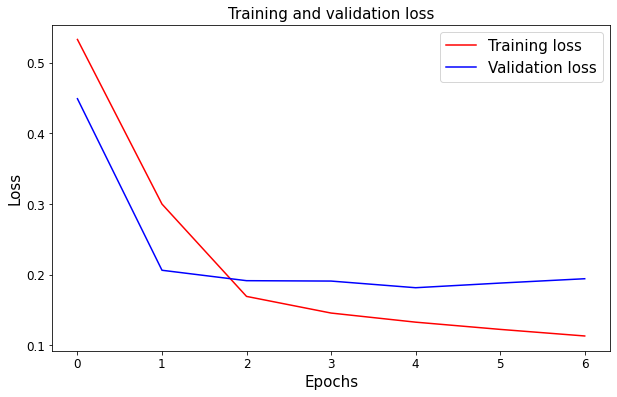

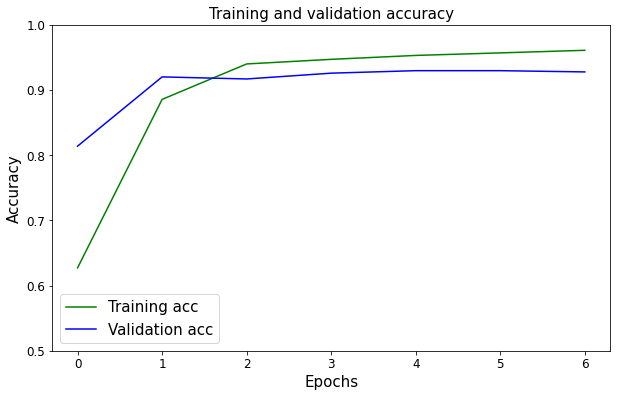

In [112]:
history_dict = history.history

acc = history_dict['accuracy']
val_acc = history_dict['val_accuracy']
loss = history_dict['loss']
val_loss = history_dict['val_loss']
epochs = history.epoch

plt.figure(figsize=(10,6))
plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss', size=15)
plt.xlabel('Epochs', size=15)
plt.ylabel('Loss', size=15)
plt.legend(prop={'size': 15})
plt.show()

plt.figure(figsize=(10,6))
plt.plot(epochs, acc, 'g', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy', size=15)
plt.xlabel('Epochs', size=15)
plt.ylabel('Accuracy', size=15)
plt.legend(prop={'size': 15})
plt.ylim((0.5,1))
plt.show()

In [113]:
model.evaluate(padded_test, y_test)

123/123 [==============================] - 10s 69ms/step - loss: 0.2206 - accuracy: 0.9125


[0.22062784433364868, 0.9125349521636963]

In [114]:
pred = model.predict(padded_test)

binary_predictions = []

for i in pred:
    if i >= 0.5:
        binary_predictions.append(1)
    else:
        binary_predictions.append(0)

In [115]:
binary_predictions

[1,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,


In [116]:
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, precision_score, recall_score, f1_score
print('Accuracy on testing set:', accuracy_score(y_test,binary_predictions))
print('Precision on testing set:', precision_score(y_test,binary_predictions))
print('Recall on testing set:', recall_score(y_test,binary_predictions))
print('F1 score on testing set:', f1_score(y_test,binary_predictions))
'''
Accuracy on testing set: 0.855580981439105
Precision on testing set: 0.9962546816479401
Recall on testing set: 0.8266003729024238
F1 score on testing set: 0.9035326086956522
'''

'''
# when out_dim=128 based on syntax from guided project about fake news
Accuracy on testing set: 0.8039664378337147
Precision on testing set: 0.9967519285424279
Recall on testing set: 0.7628962088253574
F1 score on testing set: 0.8642844569618026
'''

'''
# when out_dim=240 based on syntax from guided project about fake news
# however, gives this msg: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
Accuracy on testing set: 0.9382151029748284
Precision on testing set: 0.9904385097263435
Recall on testing set: 0.9334990677439403
F1 score on testing set: 0.9611262198048312
'''

'''
when using SusanLi code and set embedding_dim=128
Accuracy on testing set: 0.5237732011187389
Precision on testing set: 0.997779422649889
Recall on testing set: 0.41889372280919823
F1 score on testing set: 0.5900634712190851
'''

'''
- when using SusanLi code and set embedding_dim=64
i) batch_size=30
Accuracy on testing set: 0.8182049326214086
Precision on testing set: 0.8182049326214086
Recall on testing set: 1.0
F1 score on testing set: 0.9000139840581737

ii) batch_size=50
Accuracy on testing set: 0.8182049326214086
Precision on testing set: 0.8182049326214086
Recall on testing set: 1.0
F1 score on testing set: 0.9000139840581737

ii) batch_size=40
Accuracy on testing set: 0.8182049326214086
Precision on testing set: 0.8182049326214086
Recall on testing set: 1.0
F1 score on testing set: 0.9000139840581737


iii) epochs=30, batch_size=30
- run 1)
Accuracy on testing set: 0.8087973557081108
Precision on testing set: 0.9971774193548387
Recall on testing set: 0.7684897451833437
F1 score on testing set: 0.8680238680238681
- run 2)
Accuracy on testing set: 0.9021103483346046
Precision on testing set: 0.9957997899894995
Recall on testing set: 0.8840894965817278
F1 score on testing set: 0.9366255144032922


iii) epochs=10, batch_size=30
- run 1)
Accuracy on testing set: 0.9135519959318587
Precision on testing set: 0.9911262798634812
Recall on testing set: 0.9024238657551275
F1 score on testing set: 0.9446974625894601
- run 2)
Accuracy on testing set: 0.29010933129926264
Precision on testing set: 1.0
Recall on testing set: 0.13238036047234308
F1 score on testing set: 0.23380900109769487


iv) epochs=5, batch_size=30
Accuracy on testing set: 0.9061784897025171
Precision on testing set: 0.9944463727872267
Recall on testing set: 0.8903045369794904
F1 score on testing set: 0.9394982784062962

v) epochs=30, batch_size=100
Accuracy on testing set: 0.9272819730485634
Precision on testing set: 0.9906291834002677
Recall on testing set: 0.9198259788688626
F1 score on testing set: 0.9539155655816952

vi)
epochs=30, batch_size=200
Accuracy on testing set: 0.9255021612001018
Precision on testing set: 0.988313856427379
Recall on testing set: 0.9198259788688626
F1 score on testing set: 0.9528408176404313

vii)
epochs=10, batch_size=32
Accuracy on testing set: 0.9132977370963641
Precision on testing set: 0.9938208032955715
Recall on testing set: 0.8996270975761342
F1 score on testing set: 0.944381014516392

epochs=100, batch_size=200
Accuracy on testing set: 0.9282990083905416
Precision on testing set: 0.9860927152317881
Recall on testing set: 0.925419515226849
F1 score on testing set: 0.9547932029496633

viii)
epochs=10, batch_size=32
Accuracy on testing set: 0.8677854055428426
Precision on testing set: 0.9963208241353937
Recall on testing set: 0.8415164698570541
F1 score on testing set: 0.9123989218328842
'''


Accuracy on testing set: 0.9125349605898805
Precision on testing set: 0.992798353909465
Recall on testing set: 0.8996270975761342
F1 score on testing set: 0.9439191392239973


'\n- when using SusanLi code and set embedding_dim=64\ni) batch_size=30\nAccuracy on testing set: 0.8182049326214086\nPrecision on testing set: 0.8182049326214086\nRecall on testing set: 1.0\nF1 score on testing set: 0.9000139840581737\n\nii) batch_size=50\nAccuracy on testing set: 0.8182049326214086\nPrecision on testing set: 0.8182049326214086\nRecall on testing set: 1.0\nF1 score on testing set: 0.9000139840581737\n\nii) batch_size=40\nAccuracy on testing set: 0.8182049326214086\nPrecision on testing set: 0.8182049326214086\nRecall on testing set: 1.0\nF1 score on testing set: 0.9000139840581737\n\n\niii) epochs=30, batch_size=30\n- run 1)\nAccuracy on testing set: 0.8087973557081108\nPrecision on testing set: 0.9971774193548387\nRecall on testing set: 0.7684897451833437\nF1 score on testing set: 0.8680238680238681\n- run 2)\nAccuracy on testing set: 0.9021103483346046\nPrecision on testing set: 0.9957997899894995\nRecall on testing set: 0.8840894965817278\nF1 score on testing set: 

In [117]:
print(classification_report(y_test, binary_predictions))

'''
# w/o early stop, epochs=10, batch_size=32
             precision    recall  f1-score   support

           0       0.60      0.94      0.73       715
           1       0.99      0.86      0.92      3218

    accuracy                           0.88      3933
   macro avg       0.79      0.90      0.83      3933
weighted avg       0.92      0.88      0.89      3933


# epochs=10, batch_size=32
            precision    recall  f1-score   support

           0       0.58      0.99      0.73       715
           1       1.00      0.84      0.91      3218

    accuracy                           0.87      3933
   macro avg       0.79      0.91      0.82      3933
weighted avg       0.92      0.87      0.88      3933
'''

              precision    recall  f1-score   support

           0       0.68      0.97      0.80       715
           1       0.99      0.90      0.94      3218

    accuracy                           0.91      3933
   macro avg       0.84      0.94      0.87      3933
weighted avg       0.94      0.91      0.92      3933



'\n# w/o early stop, epochs=10, batch_size=32\n             precision    recall  f1-score   support\n\n           0       0.60      0.94      0.73       715\n           1       0.99      0.86      0.92      3218\n\n    accuracy                           0.88      3933\n   macro avg       0.79      0.90      0.83      3933\nweighted avg       0.92      0.88      0.89      3933\n\n\n# epochs=10, batch_size=32\n            precision    recall  f1-score   support\n\n           0       0.58      0.99      0.73       715\n           1       1.00      0.84      0.91      3218\n\n    accuracy                           0.87      3933\n   macro avg       0.79      0.91      0.82      3933\nweighted avg       0.92      0.87      0.88      3933\n'

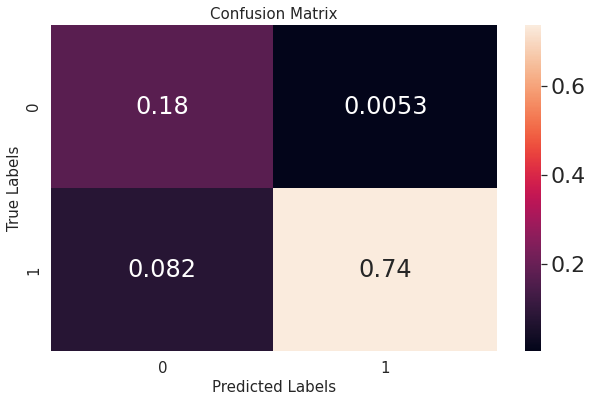

In [118]:
matrix = confusion_matrix(y_test, binary_predictions,normalize='all')
plt.figure(figsize=(10, 6))
sns.set(font_scale=2.0) # Adjust to fit
ax= plt.subplot()
sns.heatmap(matrix, annot=True, ax = ax)

# labels, title and ticks
ax.set_xlabel('Predicted Labels', size=15)
ax.set_ylabel('True Labels', size=15)
ax.set_title('Confusion Matrix', size=15)
ax.xaxis.set_ticklabels([0,1], size=15)
ax.yaxis.set_ticklabels([0,1], size=15);

'\nAccuracy= (TP + TN)/(TP + TN + FP + FN)=0.858369098712446\nPrecision=TP/(TP + FP)=0.999629766753054\nRecall=TP/(TP + FN)=0.828220858895706\nF1 score=(2 x Precision x Recall)/(Precision + Recall)=0.905888273779567\n'

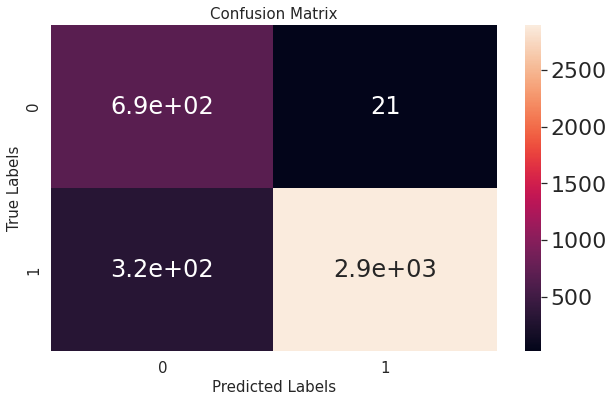

In [119]:
matrix = confusion_matrix(y_test,binary_predictions)
plt.figure(figsize=(10, 6))
sns.set(font_scale=2.0) # Adjust to fit
ax= plt.subplot()
sns.heatmap(matrix, annot=True, ax = ax)

# labels, title and ticks
ax.set_xlabel('Predicted Labels', size=15)
ax.set_ylabel('True Labels', size=15)
ax.set_title('Confusion Matrix', size=15)
ax.xaxis.set_ticklabels([0,1], size=15)
ax.yaxis.set_ticklabels([0,1], size=15);

'''
TN=7000
FP=10
FN=5600
TP=27000
Total=39610
'''

'''
# cross check with confusion matrix above
TN=7000       FP=10
FN=5600       TP=27000
Total=39610
7000/39610=0.176723049734915      10/39610=0.000252461499621308
5600/39610=0.141378439787932      39610/39610=0.681646048977531
'''

'''
Accuracy= (TP + TN)/(TP + TN + FP + FN)=0.858369098712446
Precision=TP/(TP + FP)=0.999629766753054
Recall=TP/(TP + FN)=0.828220858895706
F1 score=(2 x Precision x Recall)/(Precision + Recall)=0.905888273779567
'''
# 

# w/o early stop, epochs=10, batch_size=32
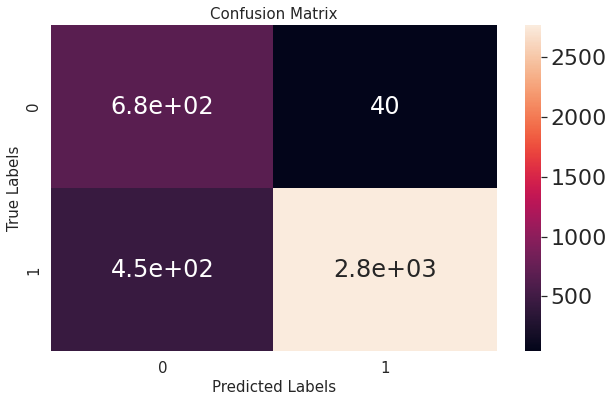

# epochs=10, batch_size=32

[link text](https://)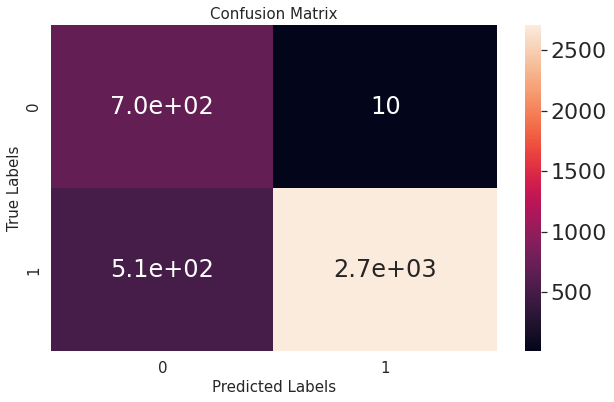

In [120]:
# model.fit(padded_train, y_train, batch_size = 64, validation_split = 0.1, epochs = 2)
'''
Epoch 1/2
222/222 [==============================] - 283s 1s/step - loss: 0.4626 - accuracy: 0.8159 - val_loss: 0.2657 - val_accuracy: 0.8163
Epoch 2/2
222/222 [==============================] - 321s 1s/step - loss: 0.1663 - accuracy: 0.9320 - val_loss: 0.1727 - val_accuracy: 0.9352
'''

# model.fit(padded_train, y_train, batch_size = 64, validation_split = 0.1, epochs = 10)
'''
Epoch 1/10
222/222 [==============================] - 252s 1s/step - loss: 0.1335 - accuracy: 0.9475 - val_loss: 0.1709 - val_accuracy: 0.9332
Epoch 2/10
222/222 [==============================] - 307s 1s/step - loss: 0.1163 - accuracy: 0.9534 - val_loss: 0.1827 - val_accuracy: 0.9307
Epoch 3/10
222/222 [==============================] - 339s 2s/step - loss: 0.1079 - accuracy: 0.9580 - val_loss: 0.1645 - val_accuracy: 0.9313
Epoch 4/10
222/222 [==============================] - 351s 2s/step - loss: 0.0946 - accuracy: 0.9631 - val_loss: 0.1979 - val_accuracy: 0.9250
Epoch 5/10
222/222 [==============================] - 354s 2s/step - loss: 0.0820 - accuracy: 0.9691 - val_loss: 0.2014 - val_accuracy: 0.9256
Epoch 6/10
222/222 [==============================] - 317s 1s/step - loss: 0.0731 - accuracy: 0.9743 - val_loss: 0.2026 - val_accuracy: 0.9263
Epoch 7/10
222/222 [==============================] - 272s 1s/step - loss: 0.0667 - accuracy: 0.9771 - val_loss: 0.2317 - val_accuracy: 0.9224
Epoch 8/10
222/222 [==============================] - 354s 2s/step - loss: 0.0620 - accuracy: 0.9796 - val_loss: 0.2792 - val_accuracy: 0.9193
Epoch 9/10
222/222 [==============================] - 291s 1s/step - loss: 0.0506 - accuracy: 0.9840 - val_loss: 0.3352 - val_accuracy: 0.9161
Epoch 10/10
222/222 [==============================] - 308s 1s/step - loss: 0.0498 - accuracy: 0.9838 - val_loss: 0.2939 - val_accuracy: 0.9186
'''

# model.fit(padded_train, y_train, batch_size = 64, validation_split = 0.1, epochs = 10,callbacks=[early_stop])
'''
Epoch 1/10
222/222 [==============================] - 949s 4s/step - loss: 0.0408 - accuracy: 0.9883 - val_loss: 0.3195 - val_accuracy: 0.9154
Epoch 2/10
222/222 [==============================] - 2915s 13s/step - loss: 0.0390 - accuracy: 0.9887 - val_loss: 0.3623 - val_accuracy: 0.8957
Epoch 3/10
222/222 [==============================] - 871s 4s/step - loss: 0.0439 - accuracy: 0.9857 - val_loss: 0.3192 - val_accuracy: 0.9059
Epoch 4/10
222/222 [==============================] - 894s 4s/step - loss: 0.0340 - accuracy: 0.9903 - val_loss: 0.3962 - val_accuracy: 0.9123
Epoch 5/10
222/222 [==============================] - 1218s 5s/step - loss: 0.0288 - accuracy: 0.9923 - val_loss: 0.3568 - val_accuracy: 0.9167
'''

'\nEpoch 1/10\n222/222 [==============================] - 949s 4s/step - loss: 0.0408 - accuracy: 0.9883 - val_loss: 0.3195 - val_accuracy: 0.9154\nEpoch 2/10\n222/222 [==============================] - 2915s 13s/step - loss: 0.0390 - accuracy: 0.9887 - val_loss: 0.3623 - val_accuracy: 0.8957\nEpoch 3/10\n222/222 [==============================] - 871s 4s/step - loss: 0.0439 - accuracy: 0.9857 - val_loss: 0.3192 - val_accuracy: 0.9059\nEpoch 4/10\n222/222 [==============================] - 894s 4s/step - loss: 0.0340 - accuracy: 0.9903 - val_loss: 0.3962 - val_accuracy: 0.9123\nEpoch 5/10\n222/222 [==============================] - 1218s 5s/step - loss: 0.0288 - accuracy: 0.9923 - val_loss: 0.3568 - val_accuracy: 0.9167\n'

### https://www.coursera.org/programs/novartis-learning-program-hdkgo/browse?authProvider=novartisglobal&productId=wZaJzMblEeqIqgqjsj89_Q&productType=course&query=Fake+News+Detection+with+Machine+Learning&showMiniModal=true

In [121]:
end = time.time()
print(end - start)

1167.2371129989624
